In [1]:
!pip install inspyred
import os

# As needed, reset cwd to jupyter notebook location
nb4_path = (
    "/mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations"
    "/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing"
    "/batch_run_files/"
)
if os.getcwd() != nb4_path:
    os.chdir(nb4_path)

In [2]:
## NB3 Functions
from netpyne import specs
import shutil

## Hold Neuron Locations Constant Across Simulations
def const_net_params():
    netParams = specs.NetParams()   # object of class NetParams to store the network parameters
    
    ## Population parameters
    netParams.sizeX = 4000 # x-dimension (horizontal length) size in um
    netParams.sizeY = 2000 # y-dimension (vertical height or cortical depth) size in um
    netParams.sizeZ = 0 # z-dimension (horizontal length) size in um
    netParams.probLengthConst = 500 # length constant for conn probability (um)    
    netParams.popParams['E'] = {
        'cellType': 'E', 
        'numCells': 300, 
        'yRange': [100,1900], 
        'xRange': [100,3900]}
    netParams.popParams['I'] = {
        'cellType': 'I', 
        'numCells': 100, 
        'yRange': [100,1900], 
        'xRange': [100,3900]}
    
    ##Save network params to file
    filename = 'const_netParams'
    netParams.save(filename+'.json')
    return netParams

##
def move_plots_to_plots_folder(gen_path):
    # import shutil
    # import os
    # Move plots to plots folder
    # General Plot folder
    #plots_folder = '/mnt/disk15tb/adam/git_workspace/netpyne/hdmea_simulations/BurstingPlotDevelopment/nb4_selecting_params1/plots/'
    plots_folder = nb4_path.replace('batch_run_files', 'plots')
    if not os.path.exists(plots_folder):
        os.makedirs(plots_folder)  

    #destination for gen plots
    gen_dir = os.path.basename(os.path.normpath(gen_path))
    gen_plot_path = plots_folder + gen_dir + '/'
    if not os.path.exists(gen_plot_path):
        os.makedirs(gen_plot_path) 

    # Move plots to gen_plot_path
    for root, dirs, files in os.walk(gen_path):
        for file in files:
            if file.endswith(".png") or file.endswith(".svg"):                
                #control file names
                file = control_file_names(root, file)
                
                if 'raster' in file:
                    #destination for gen raster plots
                    gen_raster_path = gen_plot_path + 'raster/'
                    if not os.path.exists(gen_raster_path):
                        os.makedirs(gen_raster_path)
                    shutil.move(root+'/'+file, gen_raster_path+file)

                elif '2Dnet' in file:
                     #destination for net_conns plots
                    net_conns_path = gen_plot_path + '2Dnet_conns/'
                    if not os.path.exists(net_conns_path):
                        os.makedirs(net_conns_path)                
                    shutil.move(root+'/'+file, net_conns_path+file)

                elif 'conn_matrix' in file:
                    #destination for connectivity matrix plots
                    conn_matrix_path = gen_plot_path + 'conn_matrix/'
                    if not os.path.exists(conn_matrix_path):
                        os.makedirs(conn_matrix_path)
                    shutil.move(root+'/'+file, conn_matrix_path+file)

                elif 'network_activity' in file:
                    #destination for network_activity
                    net_activity_path = gen_plot_path + 'net_activity/'
                    if not os.path.exists(net_activity_path):
                        os.makedirs(net_activity_path)                            
                    shutil.move(root+'/'+file, net_activity_path+file)

                elif 'net_activity_raster' in file:
                    #destination for network_activity and raster (combined_fig)
                    net_activity_raster_path = gen_plot_path + 'net_activity_raster_figs/'
                    if not os.path.exists(net_activity_raster_path):
                        os.makedirs(net_activity_raster_path)                   
                    shutil.move(root+'/'+file, net_activity_raster_path+file)

                elif 'conn_summary' in file:
                    #destination for connectivity matrix and_net_conns plots (combined_fig)
                    conn_matrix_net_conns_path = gen_plot_path + 'conn_summary_figs/'
                    if not os.path.exists(conn_matrix_net_conns_path):
                        os.makedirs(conn_matrix_net_conns_path)                    
                    shutil.move(root+'/'+file, conn_matrix_net_conns_path+file)   

                elif 'param_summary' in file:
                    #destination for param_mod_summary_figs (combined_fig)
                    param_mod_summary_path = gen_plot_path + 'param_summary_figs/'
                    if not os.path.exists(param_mod_summary_path):
                        os.makedirs(param_mod_summary_path) 
                    shutil.move(root+'/'+file, param_mod_summary_path+file)

                elif 'gen_summary' in file: #or 'gen_summary_figure' in file:
                     #destination for generation_summary (combined_fig)
                    gen_summary_path = gen_plot_path + 'gen_summary_figs/'
                    if not os.path.exists(gen_summary_path):
                        os.makedirs(gen_summary_path)
                    shutil.move(root+'/'+file, gen_summary_path+file)

                elif'neuron_locs' in file: # or 'locs' in file:                
                    #destination for neuron location plots
                    neuron_loc_path = gen_plot_path # + 'neuron_loc/'
                    if not os.path.exists(neuron_loc_path):
                        os.makedirs(neuron_loc_path)
                    if os.path.exists(neuron_loc_path+file):
                        os.remove(root+'/'+file)
                    else: shutil.move(root+'/'+file, neuron_loc_path+file)
                
                elif 'sample_trace' in file:
                    #destination for sample trace plots
                    sample_trace_path = gen_plot_path + 'sample_trace_fig/'
                    if not os.path.exists(sample_trace_path):
                        os.makedirs(sample_trace_path)
                    shutil.move(root+'/'+file, sample_trace_path+file)

                #elif 'locs'
    
    #Quality check
    NetworkBurst_and_Raster_Figs = gen_path + 'NetworkBurst_and_Raster_Figs/'
    #assert that this folder is empty before deleting
    if os.path.exists(NetworkBurst_and_Raster_Figs):
        #assert that this folder is empty, else raise error
        assert not os.listdir(NetworkBurst_and_Raster_Figs), "NetworkBurst_and_Raster_Figs is not empty"
        os.rmdir(NetworkBurst_and_Raster_Figs)
        print('NetworkBurst_and_Raster_Figs folder verified to be empty before being deleted')
    else:
        print('NetworkBurst_and_Raster_Figs folder does not exist')
       
    #assert that zero .png or .svg files remain in gen_path
    # Get a list of all files in gen_path
    files = os.listdir(gen_path)
    # Filter the list for .png and .svg files
    png_svg_files = [file for file in files if file.endswith('.png') or file.endswith('.svg')]
    # Assert that no .png or .svg files remain in gen_path
    assert not png_svg_files, "gen_path still contains .png or .svg files"
    print('gen_path verified to be empty of .png and .svg files')
    print('All plots have been moved to the plots folder')

def control_file_names(root, file):
    file_new = file
    if 'plot_2Dnet' in file:
        file_new = file.replace('plot_2Dnet', '2Dnet_conns')
        #rename file
        #os.rename(root+'/'+file, root+'/'+file_new, overwrite=True)
        shutil.move(root+'/'+file, root+'/'+file_new)
    if 'network_activity_def' in file:
        file_new = file.replace('network_activity_def', 'network_activity')
        #rename file
        #os.rename(root+'/'+file, root+'/'+file_new, overwrite=True)
        shutil.move(root+'/'+file, root+'/'+file_new)
    # if 'gen_summary_fig' in file or 'combined_figure' in file:
    #         if 'combined_figure' in file:
    #             file = file.replace('combined_figure', 'gen_summary')
    if 'locs' in file:
        file_new = file.replace('locs', 'neuron_locs')
        #rename file
        #os.rename(root+'/'+file, root+'/'+file_new, overwrite=True)   
        shutil.move(root+'/'+file, root+'/'+file_new)
    if 'sample_trace' in file:
        file_new = file.replace('sample_trace_E', 'sample_trace_fig')
        #rename file
        #os.rename(root+'/'+file, root+'/'+file_new, overwrite=True)
        shutil.move(root+'/'+file, root+'/'+file_new)
    
    return file_new

import svgutils.transform as sg
import cairosvg
def generate_pdf_reports(gen_path, params):
    #plots_folder = '/mnt/disk15tb/adam/git_workspace/netpyne/hdmea_simulations/BurstingPlotDevelopment/nb4_selecting_params1/plots/'
    plots_folder = nb4_path.replace('batch_run_files', 'plots')
    if not os.path.exists(plots_folder):
        os.makedirs(plots_folder)  

    #destination for gen plots
    gen_dir = os.path.basename(os.path.normpath(gen_path))
    gen_plot_path = plots_folder + gen_dir + '/'
    if not os.path.exists(gen_plot_path):
        os.makedirs(gen_plot_path) 

    # #destination for pdf_pages
    # pdf_pages_folder = gen_plot_path + 'pdf_reports/'
    # if not os.path.exists(pdf_pages_folder):
    #     os.makedirs(pdf_pages_folder)

    # Generate pdf reports
    pdf_report_path = gen_plot_path + 'pdf_report'
    
    #load all svgs in param_summary_figs
    param_summary_path = gen_plot_path + 'param_summary_figs/'
    assert os.path.exists(param_summary_path), "param_summary_figs folder does not exist"
    param_summary_files = [f for f in os.listdir(param_summary_path) if f.endswith('.svg')]

    #count number of svgs in param_summary_figs
    num_param_summary_files = len(param_summary_files)

    # given a typical printer page size of 8.5x11 inches, and a typical margin of 0.5 inches, get height that can be dedicated to each svg
    # align all svgs to the right of the page
    page_height = 11*720 #pts per inch
    page_width = 8.5*720 #pts per inch
    margin = 0.5*720 #pts per inch
    svg_height_allowed = ((page_height - margin*2)/num_param_summary_files)     # 70% of the available height

    # Load all SVG files
    param_summary_svgs = []
    param_summary_files.sort()
    for file in param_summary_files:
        file_path = os.path.join(param_summary_path, file)
        svg = sg.fromfile(file_path)
        param_summary_svgs.append(svg)

    # Initialize the total height
    total_height = 0

    # Initialize an empty list to store the plots
    plots = []

    # Process each SVG file
    for svg in param_summary_svgs:
        # Get the root of the SVG file
        plot = svg.getroot()

        # Set the width and height of the SVG
        svg_width = float(svg.width.rstrip('pt'))  # Replace with your desired width
        svg_height = float(svg.height.rstrip('pt'))  # Replace with your desired height

        #based on svg_height_allowed, calculate the new svg_height and scale the svg_width
        plot.scale(svg_height_allowed/svg_height)
        svg_height_adj = svg_height_allowed
        svg_width_adj = svg_width * (svg_height_allowed/svg_height) 

        # Calculate the x-coordinate for the SVG to align it to the right
        x = page_width - svg_width_adj - margin

        # Move the plot to the right and down by the total height so far plus a small margin
        plot.moveto(x, margin+total_height + 5)  # Adjust the margin as needed

        # Add the height of this plot to the total height
        total_height += svg_height_adj + 5  # Add the margin

        # Add the plot to the list
        plots.append(plot)

    # Create a new SVG figure with the exact size needed to accommodate the figures
    fig_width = page_width  # The width of the figure is the same as the page width
    fig_height = page_height  # The height of the figure is the total height of all SVGs plus the margins
    fig = sg.SVGFigure(fig_width, fig_height)
    fig.set_size((str(fig_width), str(fig_height)))

    # Add the plots to the figure using a loop
    for plot in plots:
        fig.append(plot)

    #with the remaining space on the left, load neuron_locs, size to fit, and add to the figure
    neuron_loc_path = gen_plot_path
    for root, dirs, files in os.walk(neuron_loc_path):
        for file in files:
            if 'neuron_locs' in file:
                file_path = os.path.join(neuron_loc_path, file)
                svg = sg.fromfile(file_path)
                plot = svg.getroot()
                svg_width = float(svg.width.rstrip('pt'))
                svg_height = float(svg.height.rstrip('pt'))
                remaining_left_width = page_width - margin*2 -svg_width_adj
                remaining_left_width = remaining_left_width - 5 #add a small margin
                plot.scale(remaining_left_width/svg_width)
                plot.moveto(margin, margin)
                fig.append(plot)
    
    #print params below neuron_locs plot
    # Initialize the y-coordinate for the text
    y = svg_height*remaining_left_width/svg_width + margin+50  # Adjust as needed
    x = margin

    # Process each key-value pair in the params dictionary
    for key, values in params.items():
        # Create a string representation of the values
        values_str = ', '.join(map(str, values))

        # Create a text element for the key-value pair
        text = sg.TextElement(x, y, f'{key}: {values_str}', size=75)

        # Add the text element to the figure
        fig.append(text)

        # Increment the y-coordinate for the next text element
        y += 80  # Adjust as needed


    # Save the figure
    fig.set_size((str(fig._width), str(fig._height)))
    fig.save(pdf_report_path+'.svg')
    cairosvg.svg2pdf(url=pdf_report_path+'.svg', write_to=pdf_report_path+'.pdf')
    #return param_summary_fig_path 


    

    


In [3]:
from netpyne import specs
params = specs.ODict()

## Define full parameter space
#constant
const_netparams = const_net_params()
# In the future I think I want to parse this by inhibitory and excitatory cells
# Also add some jitter to this paramter from cell to cell

params['duration_seconds'] = [30, 30]
params['probLengthConst'] = [const_netparams.probLengthConst, const_netparams.probLengthConst]  # length constant for conn probability (um)

# General Net Params
# Propagation velocity
#propVelocity = 100
propVelocity = 1
params['propVelocity'] = [propVelocity, propVelocity]#, propVelocity/100, propVelocity/10, propVelocity*10, propVelocity*100]

#Cell Params
params['probEI'] = [0, 1] # min: 0.1, max: 0.3
params['weightEI'] = [0.001, 0.1] # min: 0.001, max: 0.01
params['probIE'] = [0, 1] # min: 0.2, max: 0.6
params['weightIE'] = [0.001, 0.1] # min: 0.01, max: 0.1
params['probEE'] = [0, 1] # min: 0.1, max: 0.3
params['weightEE'] = [0.001, 0.1] # min: 0.001, max: 0.01
params['probII'] = [0, 1] # min: 0.2, max: 0.6
params['weightII'] = [0.001, 0.1] # min: 0.01, max: 0.1

params['gnabar_E'] = [0, 5] 
params['gkbar_E'] = [0, 0.5] 
params['gnabar_I'] = [0, 1.5] 
params['gkbar_I'] = [0.005, 2] 

#Hold these constant for now
# params['tau1_exc'] = [0.5, 1.5] 
# params['tau2_exc'] = [3.0, 10.0] 
# params['tau1_inh'] = [0.05, 0.2] 
# params['tau2_inh'] = [5.0, 15.0]
#default values for now
params['tau1_exc'] = [0.8, 0.8]
params['tau2_exc'] = [5.3, 5.3]
params['tau1_inh'] = [0.6, 0.6]
params['tau2_inh'] = [8.5, 8.5]

#Stimulation Params
params['stimWeight'] = [0, 0.002] 
params['stim_rate'] = [0, 0.15] 
params['stim_noise'] = [0.2, 0.6] 

original_params_ = params

 Could not create 
Saving netParams to const_netParams.json ... 


In [4]:
'''
 loop through each item in params. For each iteration, modify each list of value so only the current param has
'''
#imports
import subprocess
import pickle
from collections import OrderedDict
import json
from pprint import pprint
#from batch_run_files.aw_batch_tools import plot_combined_fig
from batch_run_files.aw_batch_tools import generate_all_figures
import shutil

# 5 values, and the rest are set to the first value in their respective list
# Create a copy of the original params dictionary
original_params = original_params_.copy()
#original_params = params.copy()

# # Loop through each item in params
# gen_counter = 0
# keys = list(params.keys())  # Create a copy of keys
# #for key in params.keys():
# for key in keys:
#     if key == 'filename' or key == 'probLengthConst' or key == 'duration_seconds' or key == 'propVelocity':
#         continue
# Reset params to the original values
params = original_params.copy()

# # For each iteration, modify each list of value so only the current param has
# # 5 values, and the rest are set to the first value in their respective list    
# #try:

# #for key in keys:
# items = params.copy().items()
# for k, v in items:
#     if k==key and key:
#         params['filename'] = [f'batchGen{gen_counter}_{key}']  # Name of file to save data
#         gen_counter += 1
#         continue
#     params[k] = [v[0]]
# # assert that filename is in params
# assert 'filename' in params.keys()

# To save the OrderedDict
#output_path = ('/home/adam/workspace/git_workspace/netpyne/hdmea_simulations/BurstingPlotDevelopment/nb4_selecting_params1/output')
output_path = nb4_path.replace('batch_run_files', 'output')
if not os.path.exists(output_path):
    os.makedirs(output_path)

# Create a directory to save the batch files
# gen_dir = params['filename'][0]
# if os.path.exists(f'{output_path}/{gen_dir}') == False:
#     os.makedirs(f'{output_path}/{gen_dir}') 

with open(f'{output_path}/params.pickle', 'wb') as handle:
    pickle.dump(params, handle, protocol=pickle.HIGHEST_PROTOCOL)

#Also save as Json for easy reading
filename = f'{output_path}/params.json'
with open(filename, 'w') as file:
    json.dump(params, file, indent=4)

# Define the command
cores = 12
command = f"mpiexec -np {cores} nrniv -mpi batchRun.py"

# Run the command
switch = True
if switch:
    print(command + '\n')
    #jobName = f"{output_path}/{gen_dir}/{params['filename'][0]}"
    #jobName = f"{output_path}/{params['filename'][0]}"
    jobName = f"{output_path}/evol_batchRun"
    
    debug = False
    skip = True
    # if not skip:
    #     #empty gen_dir
    #     if os.path.exists(f'{output_path}/{gen_dir}') == True:
    #         shutil.rmtree(f'{output_path}/{gen_dir}')
    #         os.makedirs(f'{output_path}/{gen_dir}')
    if debug:
        from batch_run_files.batchRun import batchRun
        batchRun(
            batchLabel = 'batchRun', 
            method = 'evol', 
            params=None, 
            skip = skip
        ) 
    else:
        process = subprocess.Popen(command.split(' '), stdout=open(jobName + '.run', 'w'), stderr=open(jobName + '.err', 'w'))
        #process = subprocess.Popen(command, shell=True, stdout=subprocess.PIPE, stderr=subprocess.PIPE)

        # Get the output and errors, if any
        stdout, stderr = process.communicate()

        # Print the output
        pprint(stdout)

        # Print the errors
        if stderr:
            pprint(stderr)
    
    ##
    # try:
    #     #Create initial plot folder
    #     #NetworkBurst_and_Raster_paths= f'{output_path}/{gen_dir}/NetworkBurst_and_Raster_Figs/'
    #     NetworkBurst_and_Raster_paths= f'{output_path}/NetworkBurst_and_Raster_Figs/'
    #     #assert that this folder is empty before deleting
    #     if not os.path.exists(NetworkBurst_and_Raster_paths):
    #         os.makedirs(NetworkBurst_and_Raster_paths)

    #     # Generate plots
    #     generate_all_figures(
    #         fresh_figs = False,
    #         #>=30sec
    #         net_activity_params = {'binSize': .03*500, 'gaussianSigma': .12*500, 'thresholdBurst': 1.0},
    #         #<30sec
    #         #net_activity_params = {'binSize': .03*100, 'gaussianSigma': .12*100, 'thresholdBurst': 1.0},
    #         batchLabel = 'batchRun_evol'
    #         #batchLabel = params['filename'][0],
    #         #minimum peak distance = 0.5 seconds
    #         #batch_path = None
    #     )
    # except Exception as e:
    #     print('Error generating plots')
    #     print(e)
    #     pass        

    # #wrapup
    # #after all plots are generated for one generation, move and organize them in plots folder
    # move_plots_to_plots_folder(f'{output_path}/{gen_dir}/')
    
    # #these are copied into gen_dirs on for each generation, remove for tidy up
    # os.remove(f'{output_path}/params.pickle')
    # os.remove(f'{output_path}/params.json')

    # #generate generation PDF reports
    # try: 
    #     generate_pdf_reports(f'{output_path}/{gen_dir}/', params)
    # except Exception as e:
    #     pass

    #debug
    #break
params = original_params.copy()

mpiexec -np 8 nrniv -mpi batchRun.py

None


Created folder: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Error loading existing images at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Loading file /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4/gen_4_cand_2_data.json ... 
Loading simConfig...
Loading netParams...
Loading net...
  Created 400 cells
  Created 3070 connections
  Created 400 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.07 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting 2D representation of network cell locations and connections...
Plott

Traceback (most recent call last):
  File "/mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/batch_run_files/aw_batch_tools.py", line 370, in generate_primary_figures
    assert os.path.exists(raster_plot_path)
AssertionError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/adam/miniconda3/envs/mycondaenv/lib/python3.11/site-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/adam/miniconda3/envs/mycondaenv/lib/python3.11/site-packages/netpyne/plotting/plotRaster.py", line 243, in plotRaster
    popNumCells = [max(spkInds)]
                       ^^^^^^^
UnboundLocalError: cannot access local variable 'spkInds' where it is not associated with a value


Plotting connectivity matrix...
Preparing spike data...
No spikes available to plot raster
Error generating network activity plot from Data at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4/gen_4_cand_8_data.json
Error generating net_activity_raster figure at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Error generating param_summary figure at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Error loading existing images at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Loading file /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulation

Traceback (most recent call last):
  File "/mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/batch_run_files/aw_batch_tools.py", line 370, in generate_primary_figures
    assert os.path.exists(raster_plot_path)
AssertionError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/adam/miniconda3/envs/mycondaenv/lib/python3.11/site-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/adam/miniconda3/envs/mycondaenv/lib/python3.11/site-packages/netpyne/plotting/plotRaster.py", line 243, in plotRaster
    popNumCells = [max(spkInds)]
                       ^^^^^^^
UnboundLocalError: cannot access local variable 'spkInds' where it is not associated with a value


Plotting connectivity matrix...
Preparing spike data...
No spikes available to plot raster
Error generating network activity plot from Data at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4/gen_4_cand_5_data.json
Error generating net_activity_raster figure at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Error generating param_summary figure at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Error loading existing images at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Loading file /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulation

Traceback (most recent call last):
  File "/mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/batch_run_files/aw_batch_tools.py", line 370, in generate_primary_figures
    assert os.path.exists(raster_plot_path)
AssertionError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/adam/miniconda3/envs/mycondaenv/lib/python3.11/site-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/adam/miniconda3/envs/mycondaenv/lib/python3.11/site-packages/netpyne/plotting/plotRaster.py", line 243, in plotRaster
    popNumCells = [max(spkInds)]
                       ^^^^^^^
UnboundLocalError: cannot access local variable 'spkInds' where it is not associated with a value


Plotting connectivity matrix...
Preparing spike data...
No spikes available to plot raster
Error generating network activity plot from Data at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4/gen_4_cand_12_data.json
Error generating net_activity_raster figure at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Error generating param_summary figure at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Error loading existing images at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Loading file /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulatio

Traceback (most recent call last):
  File "/mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/batch_run_files/aw_batch_tools.py", line 370, in generate_primary_figures
    assert os.path.exists(raster_plot_path)
AssertionError

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/adam/miniconda3/envs/mycondaenv/lib/python3.11/site-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/adam/miniconda3/envs/mycondaenv/lib/python3.11/site-packages/netpyne/plotting/plotRaster.py", line 243, in plotRaster
    popNumCells = [max(spkInds)]
                       ^^^^^^^
UnboundLocalError: cannot access local variable 'spkInds' where it is not associated with a value


Plotting connectivity matrix...
Preparing spike data...
No spikes available to plot raster
Error generating network activity plot from Data at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4/gen_4_cand_14_data.json
Error generating net_activity_raster figure at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Error generating param_summary figure at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Error loading existing images at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4//NetworkBurst_and_Raster_Figs
Loading file /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulatio

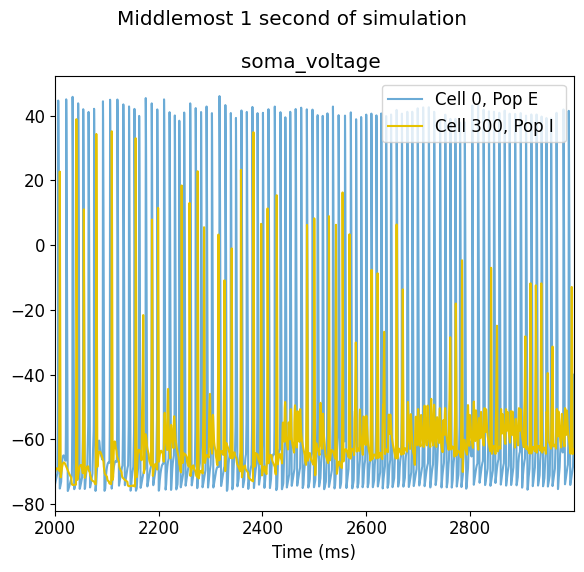

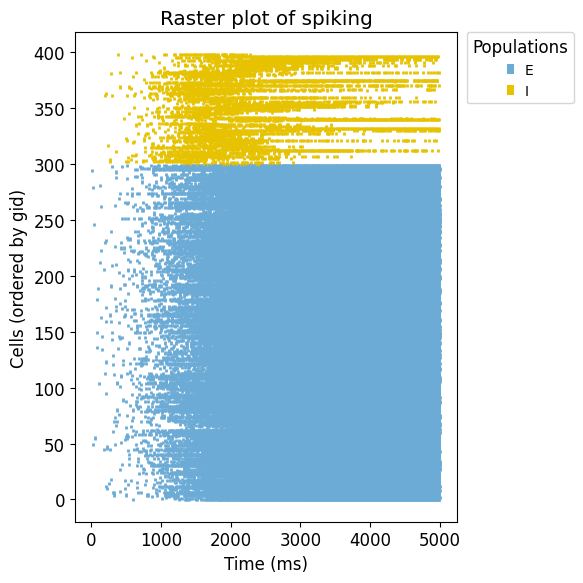

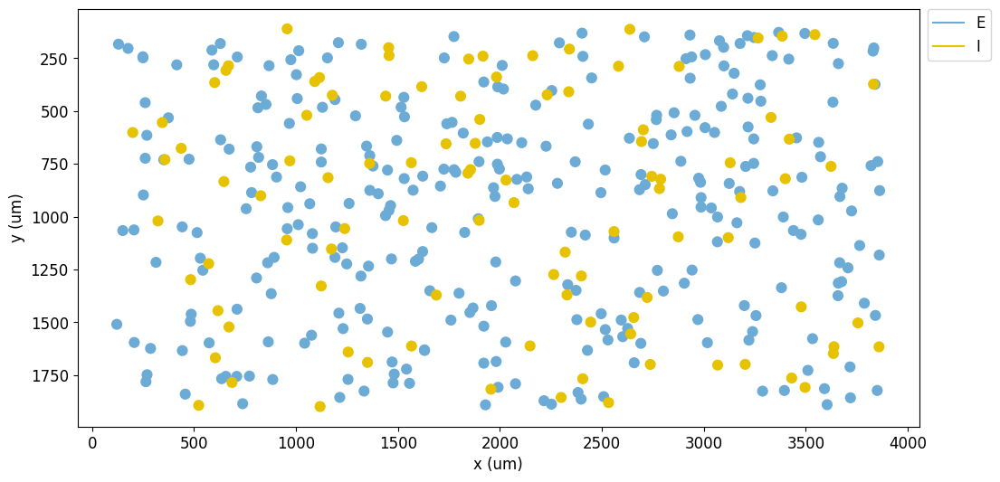

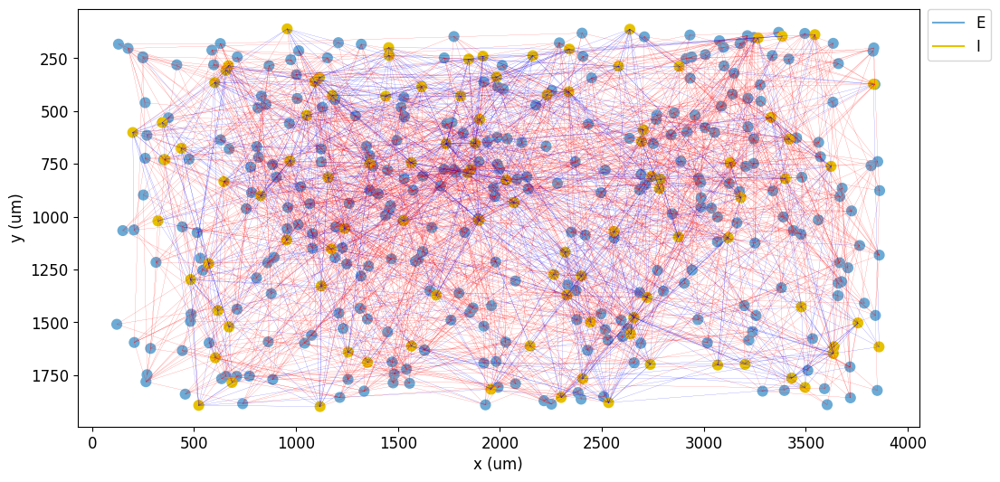

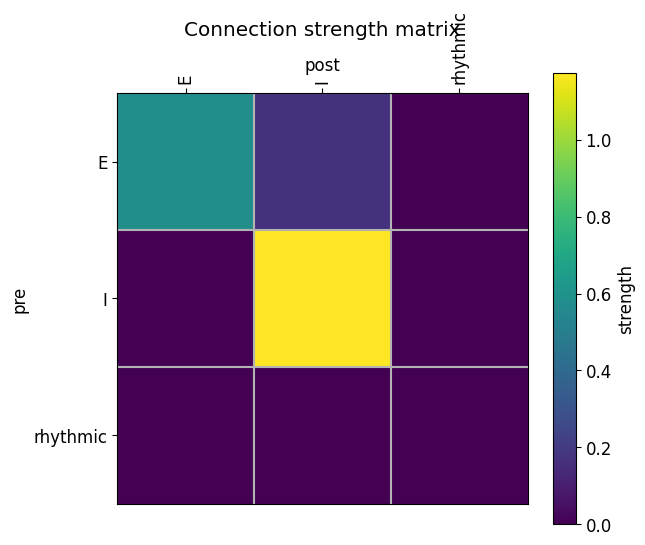

...

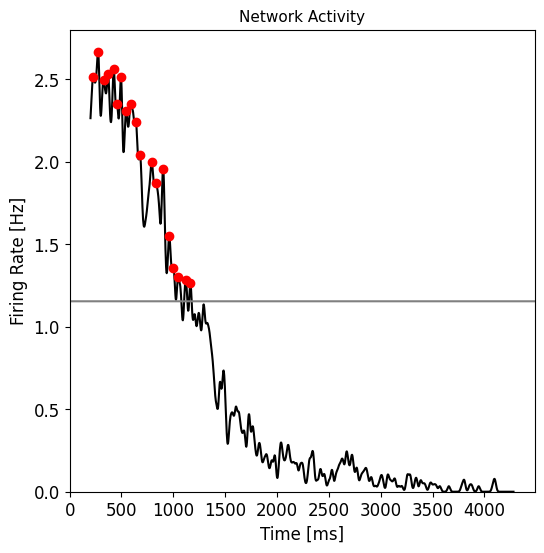

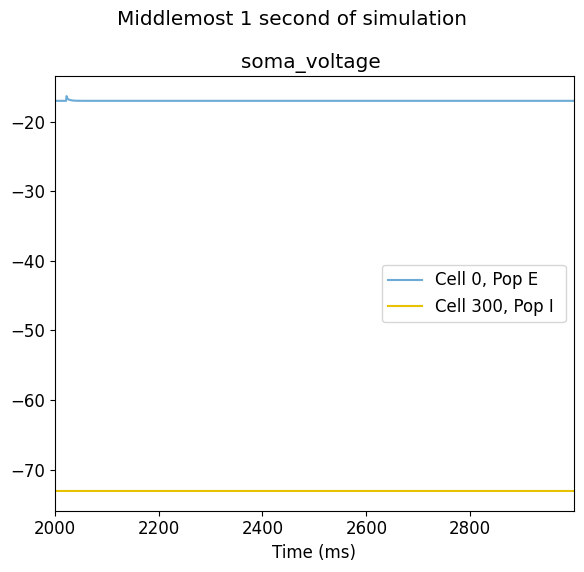

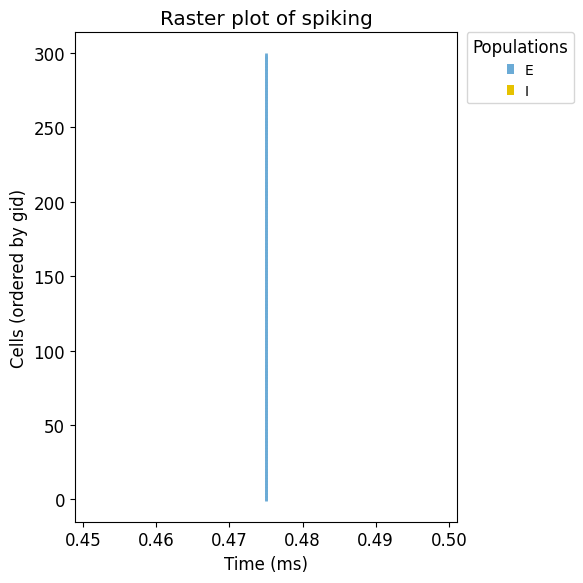

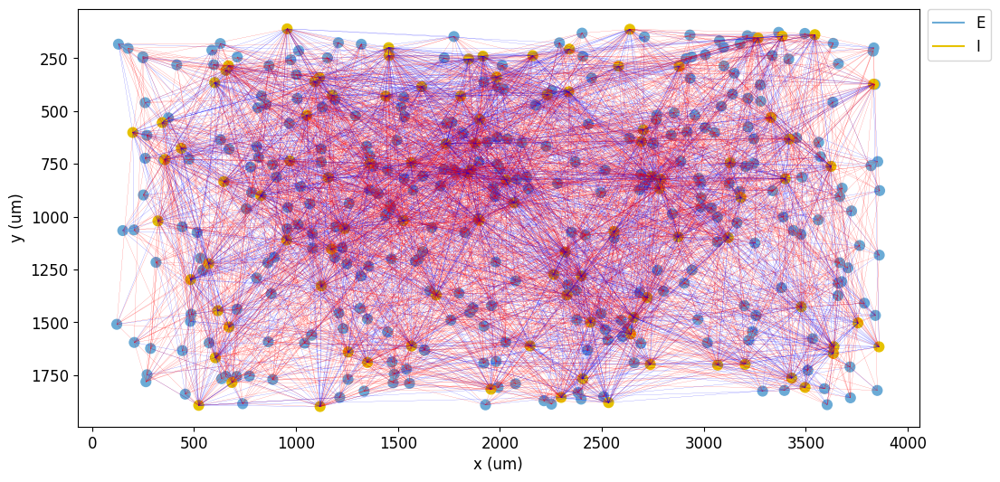

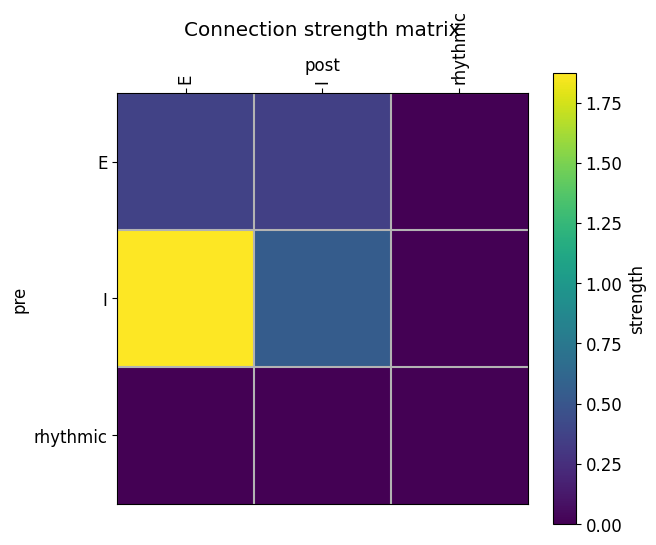

<Figure size 600x600 with 0 Axes>

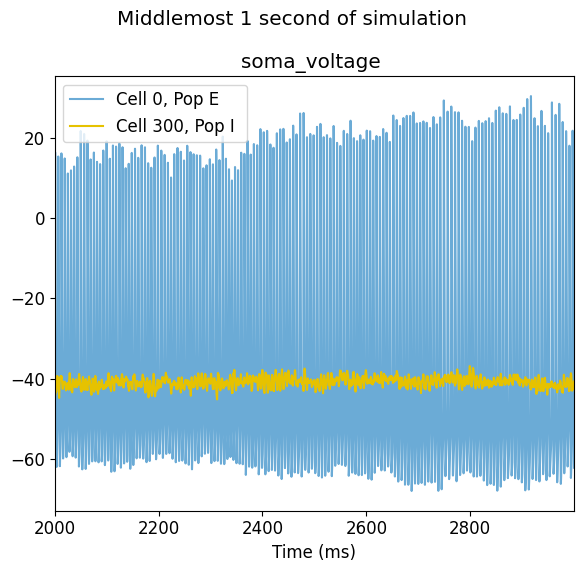

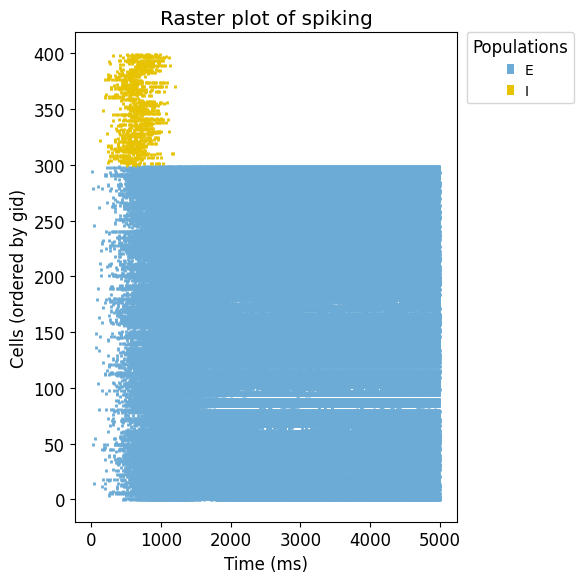

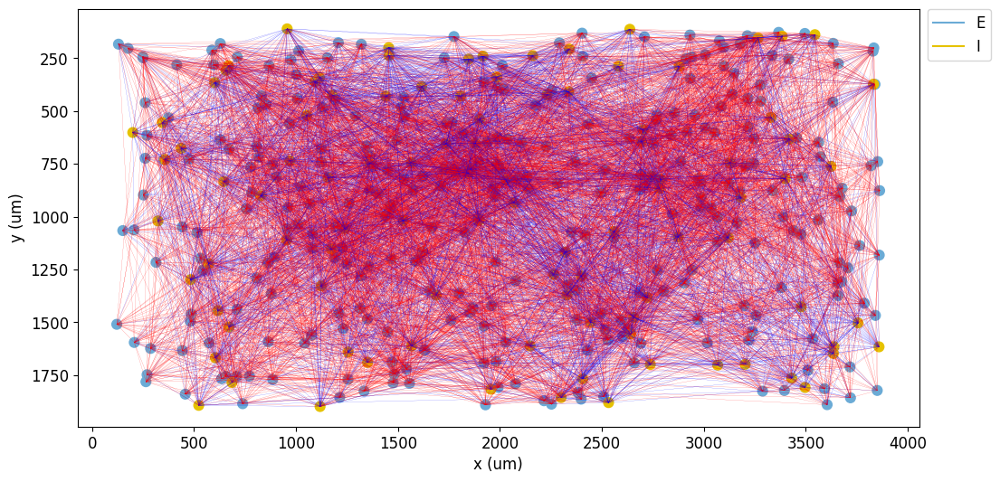

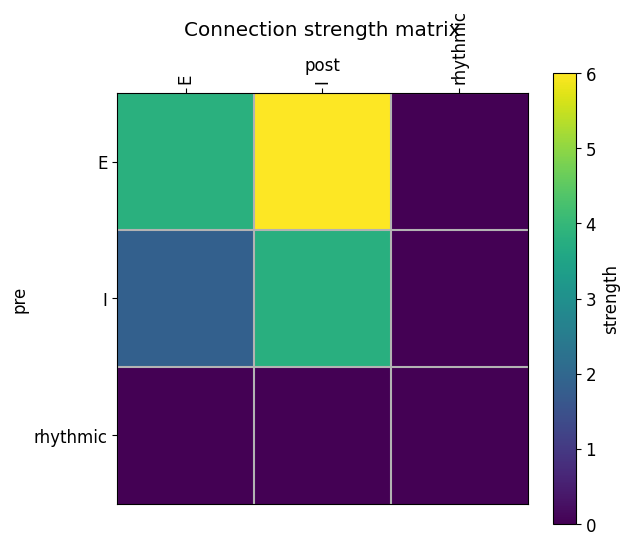

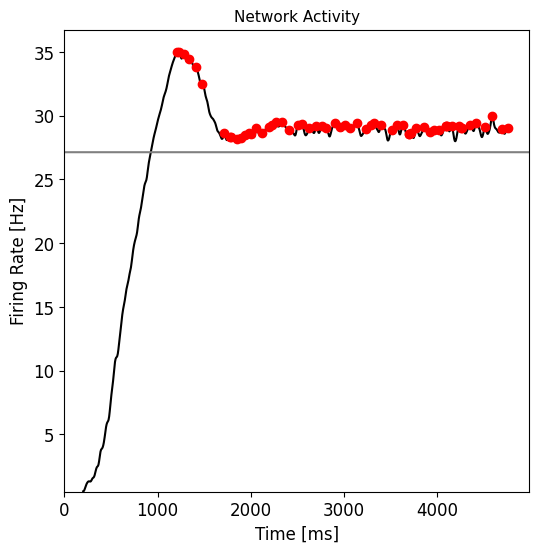

...

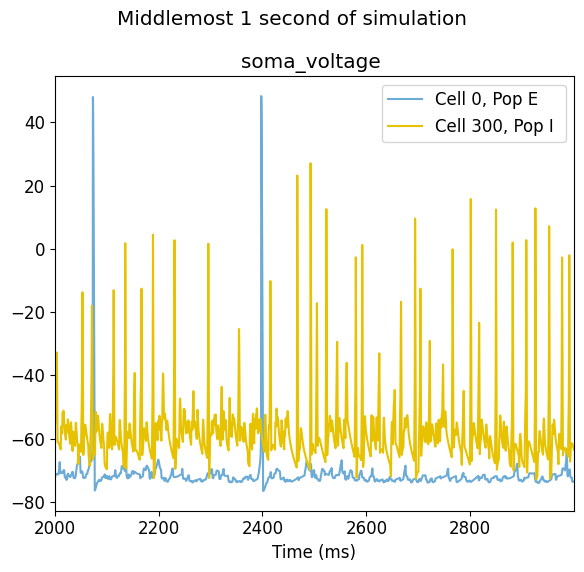

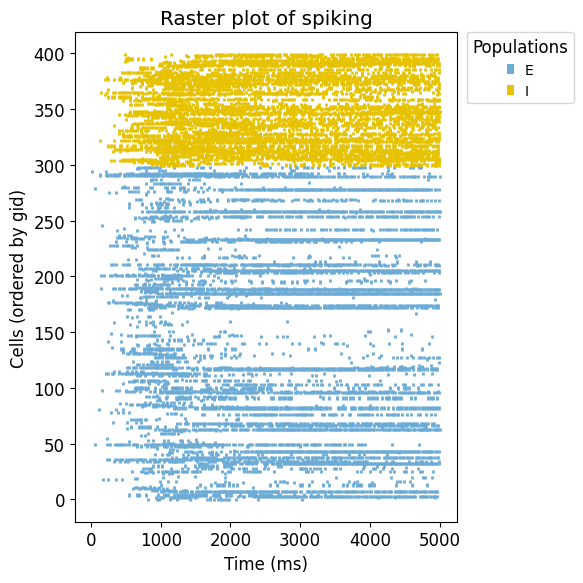

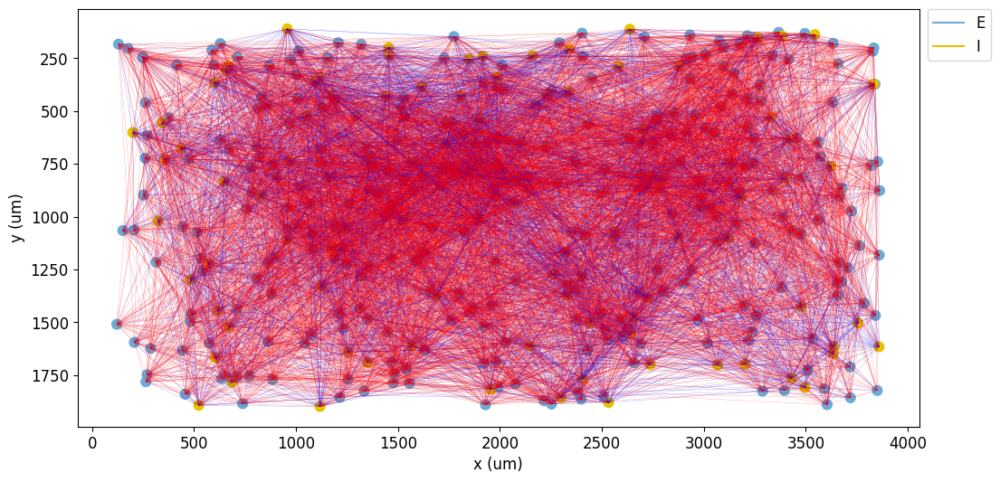

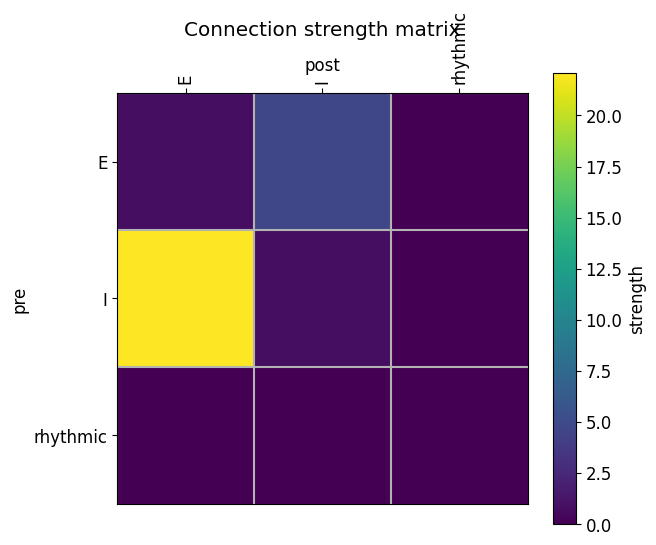

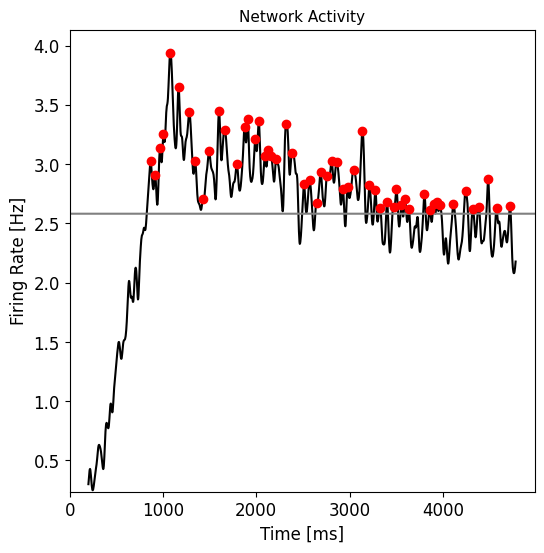

In [1]:
from batch_run_files.aw_batch_tools import generate_all_figures
generate_all_figures(
    fresh_figs = False,
    net_activity_params = {'binSize': .03*100, 
                        'gaussianSigma': .12*100, 
                        'thresholdBurst': 1.0},
    batchLabel = 'batchRun_evol',
    #batchLabel = params['filename'][0],
    #minimum peak distance = 0.5 seconds
    batch_path = '/mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_4/'
)